### Data sources:
- https://www.start.umd.edu/gtd/

- https://gist.github.com/john-guerra/43c7656821069d00dcbc

- https://geojson-maps.ash.ms/

### Column legend (PDF):
https://www.start.umd.edu/gtd/downloads/Codebook.pdf

The data source used has been modified by us; only certain columns that we utilize have been retained. For us, these include country, location, event date, number of casualties, and type.

Other data sources include GeoJSON containing the administrative division of Colombia and a global one.

# Trends and Presentation of Terrorism Worldwide and in Selected Regions

 The purpose of this notebook is to present some phenomena related to terrorism globally and in specific regions. We start by presenting an overview, showcasing the quantity of terrorist attacks worldwide and highlighting hotspots. Then, we move on to depict terrorism in two selected regions: Colombia and the Middle East. This allows us to illustrate historical trends.

In [42]:
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
import folium.plugins
import matplotlib.pyplot as plt
from folium.plugins import MarkerCluster, HeatMap, HeatMapWithTime
from matplotlib import animation
from branca.element import Template, MacroElement
from IPython.display import HTML, display, clear_output
import ipywidgets as widgets
import ast

#### The first two maps present terrorism globally.

In [43]:
raw_data = pd.read_csv("terroryzm1.csv", encoding="windows-1252", low_memory=False)
cleaned_data = raw_data.dropna(subset=['latitude', 'longitude'])
cleaned_data = gpd.GeoDataFrame(cleaned_data, geometry=gpd.points_from_xy(cleaned_data['longitude'], cleaned_data['latitude']))
cleaned_data.crs = "EPSG:4326"

In [44]:
time_index = list(cleaned_data['iyear'].sort_values().astype('str').unique())
grouped_data = cleaned_data.groupby('iyear')
data_frames_list = [group[1][['latitude', 'longitude']].values.tolist() for group in grouped_data]

map = folium.Map(tiles='cartodbpositron', zoom_start=3, location=[0, 15])

HeatMapWithTime(data_frames_list,
               index = time_index,
               auto_play=False,
               ).add_to(map)

map

In [45]:
def map_country_names(data_countries, country_name_mapping):
    return {country_name_mapping.get(country, country) for country in data_countries}

def create_popup_message(row):
    date = f"{row['iyear']}-{row['imonth'] if row['imonth'] != 0 else ''}-{row['iday'] if row['iday'] != 0 else ''}"
    return f"Date: {date} Attack Type: {row['attacktype1_txt']}"


country_name_mapping = {
    'East Germany (GDR)': 'Germany',
    'West Germany (FRG)': 'Germany',
    'United States': 'United States of America',
    'Tanzania': 'United Republic of Tanzania',
    'Bahamas': 'The Bahamas',
    'St. Lucia': 'Saint Lucia',
    'Martinique': 'France',
    'West Bank and Gaza Strip': 'West Bank',
    'Czechoslovakia': 'Czech Republic',
    'Mauritius': 'Mauritius',
    'Comoros': 'Comoros',
    'South Vietnam': 'Vietnam',
    'St. Kitts and Nevis': 'Saint Kitts and Nevis',
    'New Hebrides': 'Vanuatu',
    'Maldives': 'Maldives',
    'North Yemen': 'Yemen',
    'Dominica': 'Dominica',
    'Vatican City': 'Italy',
    'Bosnia-Herzegovina': 'Bosnia and Herzegovina',
    'Yugoslavia': 'Serbia',
    'Barbados': 'Barbados',
    'Rhodesia': 'Zimbabwe',
    'Guinea-Bissau': 'Guinea Bissau',
    'Antigua and Barbuda': 'Antigua and Barbuda',
    'Serbia-Montenegro': 'Serbia',
    'Singapore': 'Singapore',
    'Serbia': 'Republic of Serbia',
    "People's Republic of the Congo": 'Republic of the Congo',
    'Grenada': 'Grenada',
    'French Polynesia': 'France',
    'Seychelles': 'Seychelles',
    'Wallis and Futuna': 'France',
    'Zaire': 'Democratic Republic of the Congo',
    'Slovak Republic': 'Slovakia',
    'South Yemen': 'Yemen',
    'International': None,
    'Hong Kong': 'China',
    'Bahrain': 'Bahrain',
    'Guadeloupe': 'France',
    'Macau': 'China',
    'Soviet Union': 'Russia',
}

cleaned_data['country_txt'] = cleaned_data['country_txt'].replace(country_name_mapping)

country_attacks = cleaned_data['country_txt'].value_counts().reset_index()
country_attacks.columns = ['country', 'attacks']

bins_edges = [0, 1500, 4000, 7000, 11000, 15000, 20000, 40000]

geo_json_data = gpd.read_file('countries.geo.json')
geo_json_data = geo_json_data.to_crs(epsg=4326)


m = folium.Map(location=[0, 0], zoom_start=3)

folium.Choropleth(
    geo_data=geo_json_data,
    name='choropleth',
    data=country_attacks,
    columns=['country', 'attacks'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    line_opacity=0.2,
    bins=bins_edges,
    legend_name='Total number of terrorist attacks in 1970-2017'
).add_to(m)

folium.LayerControl().add_to(m)

m

Countries with the highest number of attacks include Iraq, Afghanistan, Pakistan, and India. Also notable on the map is the prevalence of terrorism in regions that may not immediately come to mind, such as Colombia, Peru, and the Philippines.

The next two maps depict terrorism in Colombia. We present events based on groups and show the geographic distribution of attacks by states, allowing users to familiarize themselves with individual incidents.

In [46]:
colombia = gpd.read_file('colombia.geo.json')
colombia = colombia.to_crs(epsg=4326)

gdf = gpd.GeoDataFrame(cleaned_data, geometry=gpd.points_from_xy(cleaned_data.longitude, cleaned_data.latitude))
gdf = gdf.to_crs(epsg=4326)
points_within_colombia = gpd.sjoin(gdf, colombia, how="inner", predicate='intersects')
x_min, y_min, x_max, y_max = colombia.total_bounds

start_year = 1970
end_year = 2017
filtered_data = points_within_colombia[(points_within_colombia['iyear'] >= start_year) & (points_within_colombia['iyear'] <= end_year)]

In [47]:
joined_data = gpd.sjoin(gdf, colombia, how="inner", op='intersects')

attacks_per_state = joined_data.groupby('NOMBRE_DPT').size().reset_index(name='count')

colombia_geojson = colombia.merge(attacks_per_state, on='NOMBRE_DPT', how='left')
colombia_geojson['count'] = colombia_geojson['count'].fillna(0)  

C:\Users\Kuba\Desktop\ADP Projekt\venv\Lib\site-packages\IPython\core\interactiveshell.py:3493: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [48]:
map_colombia = folium.Map(location=[4.5709, -74.2973], zoom_start=6)

max_count = colombia_geojson['count'].max()
bin_edges = [0, 100, 250, 500, 1000, max_count]

folium.Choropleth(
    geo_data=colombia_geojson.to_json(),
    name='Choropleth',
    data=colombia_geojson,
    columns=['NOMBRE_DPT', 'count'],
    key_on='feature.properties.NOMBRE_DPT',
    fill_color='YlOrRd',
    legend_name='Number of terrorist attacks in Colombia per state',
    highlight=True,
    smooth_factor=0,
    bins=bin_edges
).add_to(map_colombia)

cluster_group = folium.FeatureGroup(name='Terrorist attack clusters')

for state in colombia_geojson['NOMBRE_DPT'].unique():
    state_data = joined_data[joined_data['NOMBRE_DPT'] == state]

    state_cluster = folium.plugins.MarkerCluster()

    for idx, row in state_data.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=f"{row['NOMBRE_DPT']}, {row['iyear']}, {'Target: ' + row['targtype1_txt']}, {'Type of attack: ' + row['attacktype1_txt']}, {'Weapon type used: ' + row['weaptype1_txt']}",
            icon=None
        ).add_to(state_cluster)

    state_cluster.add_to(cluster_group)

cluster_group.add_to(map_colombia)

def style_function(feature):
    return {
        'fillColor': '#ffffff',
        'color': 'black',
        'weight': 2,
        'dashArray': '5, 5'
    }

geojson = folium.GeoJson(
    colombia_geojson.to_json(),
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['NOMBRE_DPT', 'count'],
        aliases=['State:', 'Terrorist Attacks:'],
        localize=True
    )
).add_to(map_colombia)

folium.LayerControl().add_to(map_colombia)

map_colombia

In [49]:
top_groups = filtered_data['gname'].value_counts().head(10)
top_group_names = top_groups.index.tolist()
top_group_names.append('Other')

In [50]:
fig, ax = plt.subplots(figsize=(14, 10))

colors = ['red', 'green', 'blue', 'orange', 'purple', 'yellow', 'brown', 'pink', 'gray', 'cyan', 'black']

color_map = dict(zip(top_group_names, colors))
print(color_map)

def get_yearly_data(year):
    yearly_data = cleaned_data[cleaned_data['iyear'] == year]
    yearly_gdf = gpd.GeoDataFrame(yearly_data, geometry=gpd.points_from_xy(yearly_data.longitude, yearly_data.latitude))
    yearly_gdf.crs = "EPSG:4326"
    points_within_map = gpd.sjoin(yearly_gdf, colombia, how="inner", predicate='intersects')
    
    points_within_map['gname'] = points_within_map['gname'].apply(lambda x: x if x in top_group_names else 'Other')
    
    return points_within_map

def animate(year):
    ax.clear()
    colombia.plot(ax=ax, edgecolor='black', color='silver')
    ax.set_title(f'Terrorist Attacks in Colombia ({year})', fontdict={'fontsize': 20}, loc='left')
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    
    yearly_data = get_yearly_data(year)
    
    unique_groups = yearly_data['gname'].unique()
    for group in top_group_names:
        if group in unique_groups:
            group_data = yearly_data[yearly_data['gname'] == group]
            ax.scatter(group_data.geometry.x, group_data.geometry.y, color=color_map[group], label=group, s=15, alpha=0.7)
    
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small', title='Groups')

ax.set_axis_off()

ani = animation.FuncAnimation(fig, animate, frames=[year for year in range(1980, 2018) if year != 1993], interval=800)

def display_animation(ani):
    plt.close(ani._fig)
    return HTML(ani.to_jshtml())

plt.close(ani._fig)
HTML(ani.to_jshtml())

{'Revolutionary Armed Forces of Colombia (FARC)': 'red', 'Unknown': 'green', 'National Liberation Army of Colombia (ELN)': 'blue', 'M-19 (Movement of April 19)': 'orange', 'Narco-Terrorists': 'purple', 'Popular Liberation Army (EPL)': 'yellow', 'Simon Bolivar Guerrilla Coordinating Board (CGSB)': 'brown', 'Death Squad': 'pink', 'The Extraditables': 'gray', 'Left-Wing Guerrillas': 'cyan', 'Other': 'black'}


<Figure size 640x480 with 0 Axes>

The map below analyzes trends related to terrorism over specific years. The default range, from 2000 to 2015, highlights differences between the year before the World Trade Center attacks and the peak of ISIS development. Note: Due to Jupyter limitations, changing years requires recalculating.

IntText(value=2000, description='Start year:')

IntText(value=2015, description='End year:')

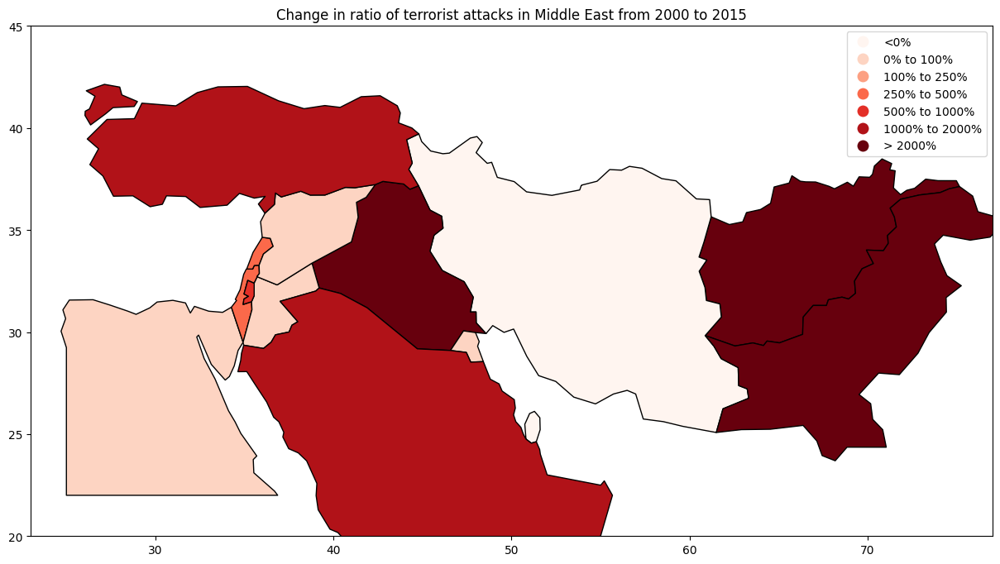

In [52]:
bins = [-float('inf'), 0, 100, 250, 500, 1000, 2000, float('inf')]
labels = ['<0%', '0% to 100%', '100% to 250%', '250% to 500%', '500% to 1000%', '1000% to 2000%', '> 2000%']

def assign_label(value):
    for i, bin_edge in enumerate(bins):
        if value <= bin_edge:
            return labels[i-1]
    return labels[-1]

geo_json_data = gpd.read_file('countries.geo.json')
geo_json_data = geo_json_data.to_crs(epsg=4326)
countries_to_display = ['Turkey', 'Syria', 'Lebanon', 'Israel', 'West Bank', 'Egypt', 'Jordan', 'Iraq', 'Kuwait', 'Saudi Arabia', 'Bahrain', 'Qatar', 'Iran', 'Afghanistan', 'Pakistan']

def plot_attack_change_map(year_range_str):
    clear_output(wait=True)
    display(start_year_dropdown)
    display(end_year_dropdown)
    year_range = ast.literal_eval(year_range_str)
    
    start_year, end_year = year_range
    
    data_year1 = cleaned_data[cleaned_data['iyear'] == int(start_year)]
    data_year2 = cleaned_data[cleaned_data['iyear'] == int(end_year)]
    
    attacks_year1 = data_year1['country_txt'].value_counts()
    attacks_year2 = data_year2['country_txt'].value_counts()

    percentage_diff = pd.DataFrame({'attacks_year1': attacks_year1, 'attacks_year2': attacks_year2})
    percentage_diff['Percentage_Difference'] = ((percentage_diff['attacks_year2'] - percentage_diff['attacks_year1']) / percentage_diff['attacks_year1']) * 100
    percentage_diff['Percentage_Difference'] = percentage_diff['Percentage_Difference'].fillna(1)
    percentage_diff['ChangeCategory'] = percentage_diff['Percentage_Difference'].apply(assign_label)
    percentage_diff['ChangeCategory'] = pd.Categorical(percentage_diff['ChangeCategory'], categories=labels, ordered=True)
    
    gdframe = gpd.GeoDataFrame(geo_json_data[['id', 'name', 'geometry']], columns=['id', 'name', 'geometry'])
    map_data = gdframe.merge(percentage_diff, left_on='name', right_index=True, how='left')
    map_data_filtered = map_data[map_data['name'].isin(countries_to_display)]
    
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    map_data_filtered.plot(column='ChangeCategory', ax=ax, legend=True, cmap='Reds', edgecolor='black')
    ax.set_xlim(23, 77)
    ax.set_ylim(20, 45)
    
    title = f'Change in ratio of terrorist attacks in Middle East from {year_range[0]} to {year_range[1]}'
    plt.title(title)
    plt.show()

start_year_dropdown = widgets.IntText(
    value=2000,
    description='Start year:',
    disabled=False
)

end_year_dropdown = widgets.IntText(
    value=2015,
    description='End year:',
    disabled=False
)

def on_dropdown_change(change):
    start_year = start_year_dropdown.value
    end_year = end_year_dropdown.value
    year_range_str = f'({start_year}, {end_year})'
    plot_attack_change_map(year_range_str)

start_year_dropdown.observe(on_dropdown_change, names='value')
end_year_dropdown.observe(on_dropdown_change, names='value')

display(start_year_dropdown)
display(end_year_dropdown)

plot_attack_change_map('(2000, 2015)')